### Training

In [1]:
# Imports
import warnings
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, MaxPool2D, Dense, Flatten, Rescaling
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import img_to_array, load_img
from keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
import os
import matplotlib.pyplot as plt
from tqdm import tqdm  # Import tqdm
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
import art
from tensorflow import keras
from keras.losses import BinaryCrossentropy
from art.attacks.evasion import FastGradientMethod
from art.attacks.evasion import ProjectedGradientDescent
from art.estimators.classification import TensorFlowV2Classifier
from art.attacks.evasion import DeepFool
from art.utils import load_dataset
from art.estimators.classification import KerasClassifier
from tensorflow.keras.losses import CategoricalCrossentropy
import numpy as np
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
warnings.filterwarnings('ignore')

2024-04-12 14:33:10.765322: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-12 14:33:10.765428: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-12 14:33:10.865906: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-12 14:33:11.169342: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-12 14:33:13.322368: W tensorflow/compiler/tf2

In [2]:
#data_augmentation = ImageDataGenerator(
#    horizontal_flip=True,
#    vertical_flip=False
#)

In [2]:
def load_dataset(folder_paths, test_size=0.2, limiter=10000):
    X = []
    y = []
    # Update the dictionary to include the new category
    label_map = {'real': 0, 'fake': 1, 'cat': 2}
    
    for folder_path in folder_paths:
        # Determine the label from the folder name
        if 'real' in folder_path:
            label = label_map['real']
        elif 'fake' in folder_path:
            label = label_map['fake']
        elif 'gatto' in folder_path:
            label = label_map['cat']
        else:
            continue  # Skip if the folder does not match any category

        files = os.listdir(folder_path)
        for filename in tqdm(files[:limiter], desc=f"Loading {folder_path}"):
            img = load_img(os.path.join(folder_path, filename), target_size=(150, 150))
            img_array = img_to_array(img)
            X.append(img_array)
            y.append(label)

    X = np.array(X)
    y = np.array(y)
    # Apply one-hot encoding to the labels
    y = to_categorical(y, num_classes=len(label_map))

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=42)
    return (X_train, y_train), (X_test, y_test)


# Paths to folders containing images:
folder_paths = [
    r"./face/real",
    r"./face/fake",
    r"./deep_fake_faces/Dataset/Train/real",
    r"./deep_fake_faces/Dataset/Train/fake",
    r"./gatto"
]

# Load dataset:
(X_train, y_train), (X_test, y_test) = load_dataset(folder_paths)


Loading ./gatto: 100%|█████████████████████████████████████████████████████████████| 1668/1668 [00:14<00:00, 114.89it/s]


In [3]:
# Normalize it for model and testing
X_train = X_train/255
X_test = X_test/255

In [4]:
#train_generator = data_augmentation.flow(X_train, y_train, batch_size=32)

In [5]:
print("X_train shape:", X_train.shape)
print(f"Image shape {X_train[0].shape}")
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)
print(y_train)
print(y_test)

X_train shape: (18967, 150, 150, 3)
Image shape (150, 150, 3)
y_train shape: (18967, 3)
X_test shape: (4742, 150, 150, 3)
y_test shape: (4742, 3)
[[0. 1. 0.]
 [1. 0. 0.]
 [0. 1. 0.]
 ...
 [1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 1. 0.]
 ...
 [1. 0. 0.]
 [1. 0. 0.]
 [0. 1. 0.]]


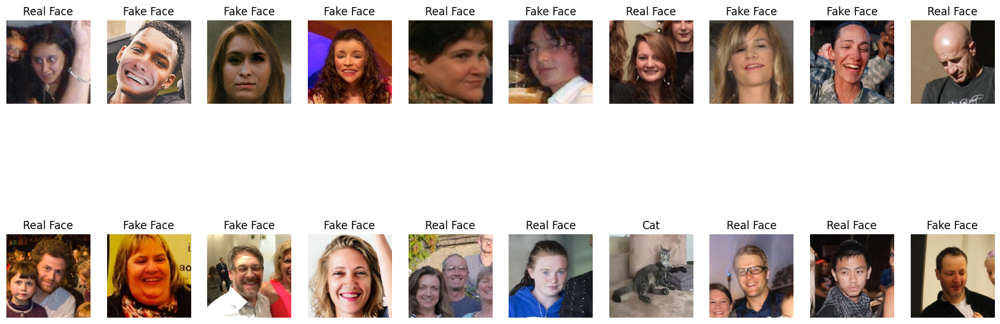

In [34]:
# Display the first 10 images:
plt.figure(figsize=(20, 8))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_test[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_test[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_test[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [7]:
def build_face_detector(input_shape=X_train[0].shape):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Flatten(),
        layers.Dense(256, activation='relu'),
        layers.Dense(512, activation='relu'),
        layers.Dense(3, activation='softmax')  # Modified to output 2 units for one-hot encoding
    ])

    model.compile(optimizer='adam',
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])

    return model

model = build_face_detector()
model.summary()


2024-04-08 08:50:47.299269: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 08:50:47.331830: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 08:50:47.331936: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 08:50:47.335255: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-08 08:50:47.335333: I external/local_xla/xla/stream_executor

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 150, 150, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 75, 75, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 37, 37, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 37, 37, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 18, 18, 128)       0

In [8]:

# Training the model with validation data:
history = model.fit(
    x=X_train,
    y=y_train,
    epochs=15,
    batch_size=32,
    validation_data=(X_test, y_test)
)

2024-04-08 08:50:56.754203: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 5121090000 exceeds 10% of free system memory.
2024-04-08 08:51:02.704073: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 5121090000 exceeds 10% of free system memory.


Epoch 1/15


2024-04-08 08:51:05.244058: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2024-04-08 08:51:05.519378: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-08 08:51:06.243847: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-08 08:51:06.293851: I external/local_xla/xla/service/service.cc:168] XLA service 0x7fc91cd5ad70 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-04-08 08:51:06.293891: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4090, Compute Capability 8.9
2024-04-08 08:51:06.300779: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1712580666.373809  410051 device_compiler.

593/593 [==============================] - 15s 19ms/step - loss: 0.6606 - accuracy: 0.6539 - val_loss: 0.4927 - val_accuracy: 0.7718
Epoch 2/15
593/593 [==============================] - 7s 12ms/step - loss: 0.4502 - accuracy: 0.7858 - val_loss: 0.4192 - val_accuracy: 0.8009
Epoch 3/15
593/593 [==============================] - 7s 12ms/step - loss: 0.3061 - accuracy: 0.8628 - val_loss: 0.2889 - val_accuracy: 0.8760
Epoch 4/15
593/593 [==============================] - 7s 12ms/step - loss: 0.2448 - accuracy: 0.8933 - val_loss: 0.2723 - val_accuracy: 0.8846
Epoch 5/15
593/593 [==============================] - 7s 11ms/step - loss: 0.1927 - accuracy: 0.9143 - val_loss: 0.2608 - val_accuracy: 0.8874
Epoch 6/15
593/593 [==============================] - 7s 11ms/step - loss: 0.1656 - accuracy: 0.9275 - val_loss: 0.3112 - val_accuracy: 0.8836
Epoch 7/15
593/593 [==============================] - 7s 12ms/step - loss: 0.1419 - accuracy: 0.9372 - val_loss: 0.2838 - val_accuracy: 0.8889
Epoch 8/1

In [9]:
model.save("faces.h5")

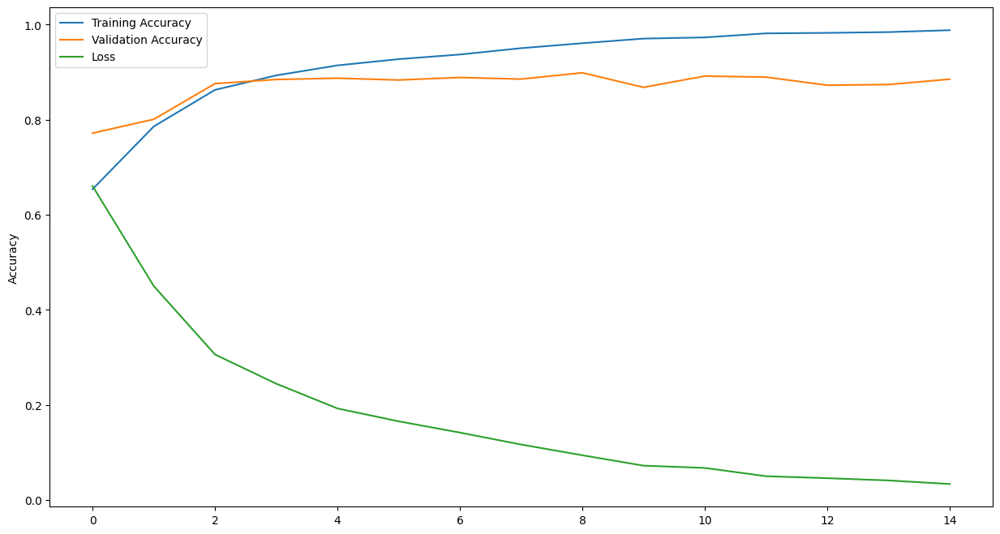

In [10]:
# Plot training and validation accuracy over epochs
plt.figure(figsize=(15, 8))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.plot(history.history['loss'], label='Loss')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [4]:
# Load model:
model = tf.keras.models.load_model('faces.h5')

# Evaluate the model on test data:
evaluation_result = model.evaluate(
    x=X_test,
    y=y_test
)

2024-04-10 08:12:14.576706: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-10 08:12:14.858117: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-10 08:12:14.858381: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-10 08:12:14.863585: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-10 08:12:14.863673: I external/local_xla/xla/stream_executor

  4/149 [..............................] - ETA: 2s - loss: 0.6029 - accuracy: 0.8828  

2024-04-10 08:12:22.904883: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


149/149 [==============================] - 4s 11ms/step - loss: 0.5360 - accuracy: 0.8853


149/149 [==============================] - 1s 5ms/step


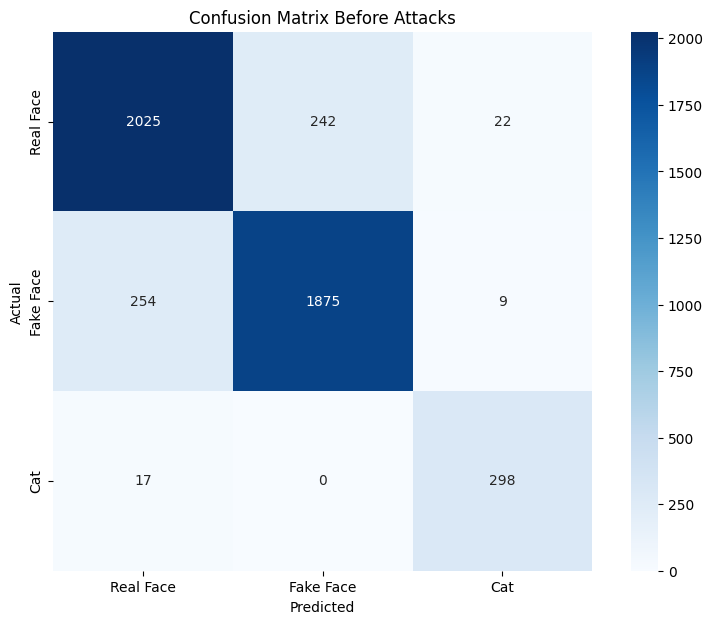

In [15]:
# Assuming model.predict outputs probabilities for each class
y_pred = model.predict(X_test)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix Before Attacks')
plt.show()

### Attacks

#### Pixel Attack

In [16]:
# Pixel Attack imports
from art.attacks.evasion import PixelAttack

In [72]:
# Pixel Attack Classifier
classifier = TensorFlowV2Classifier(
    clip_values=(0, 1),
    model=model,
    nb_classes=3,
    input_shape=X_test[0].shape,
    loss_object=tf.keras.losses.CategoricalCrossentropy()
)

# Pixel attack attack declaration
p_attack = PixelAttack(classifier=classifier, th=10, max_iter=10, es=1,targeted=False, verbose=True)

In [76]:
# Generateing the adversarial examples
X_test_pixel = p_attack.generate(x=X_test,y=y_test)

Pixel threshold: 0it [00:00, ?it/s]

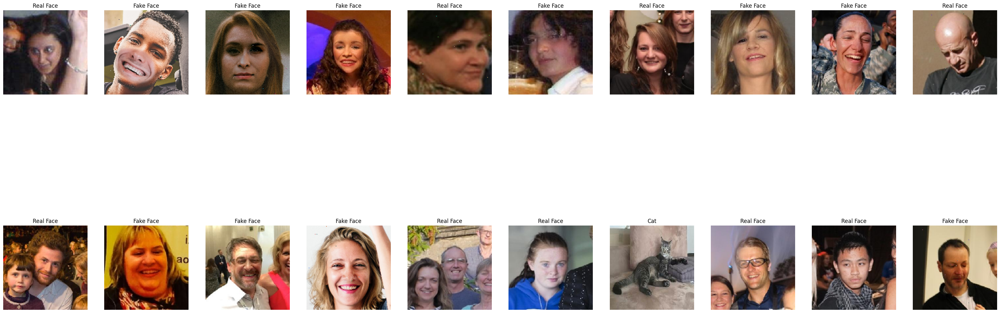

In [77]:
# Show some of the Adversarial Examples

plt.figure(figsize=(40, 16))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_test_pixel[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_test[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_test[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [78]:
import os
import numpy as np
from tensorflow.keras.preprocessing.image import save_img


# Assuming `y_test` is one-hot encoded and `X_test_pixel` represents the images in pixel format

# Create a directory for the adversarial examples if it doesn't exist
save_dir_base = "./pa_images_random"
os.makedirs(save_dir_base, exist_ok=True)

# Directories for each label
label_dirs = ['real', 'fake', 'cat']
for label_dir in label_dirs:
    os.makedirs(os.path.join(save_dir_base, label_dir), exist_ok=True)

# Filter and randomly select 25 indices for each label
# Adjust these lines for one-hot encoded labels
indices_real = np.where(np.argmax(y_test, axis=1) == 0)[0]
indices_fake = np.where(np.argmax(y_test, axis=1) == 1)[0]
indices_cat = np.where(np.argmax(y_test, axis=1) == 2)[0]

selected_indices_real = np.random.choice(indices_real, 25, replace=False)
selected_indices_fake = np.random.choice(indices_fake, 25, replace=False)
selected_indices_cat = np.random.choice(indices_cat, 25, replace=False)

# Define a function to save images based on their indices and label directory
def save_images(indices, label_dir):
    for i, idx in enumerate(indices):
        image_path = os.path.join(save_dir_base, label_dir, f"{label_dir}_example_{i+1}.png")
        img_to_save = (X_test_pixel[idx] * 255).astype('uint8')  # Rescale if needed
        save_img(image_path, img_to_save)

# Save the images for each label
save_images(selected_indices_real, 'real')
save_images(selected_indices_fake, 'fake')
save_images(selected_indices_cat, 'cat')

print(f"Saved adversarial examples in: {save_dir_base}")

Saved adversarial examples in: ./pa_images_random


##### My model

In [79]:
evaluation_result = model.evaluate(
    x=X_test_pixel,
    y=y_test
)

149/149 [==============================] - 1s 8ms/step - loss: 1.1740 - accuracy: 0.7539


149/149 [==============================] - 1s 8ms/step


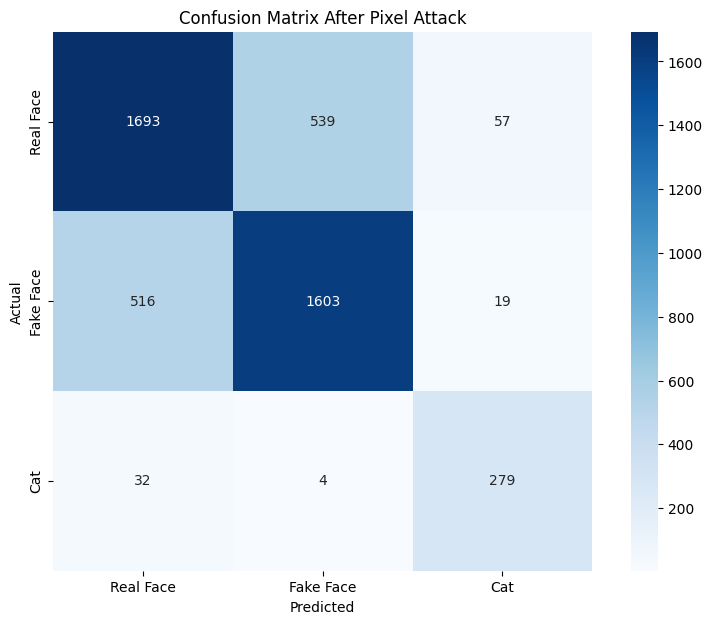

In [80]:
#Test my model on the adversarial examples
# Assuming model.predict outputs probabilities for each class
y_pred = model.predict(X_test_pixel)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix After Pixel Attack')
plt.show()

In [81]:
# Create Adversarial Training Data 50% of total dataset, the first 9483 images.
X_train_pixel = p_attack.generate(x=X_train[:9483],y=y_train[:9483])

Pixel threshold: 0it [00:00, ?it/s]

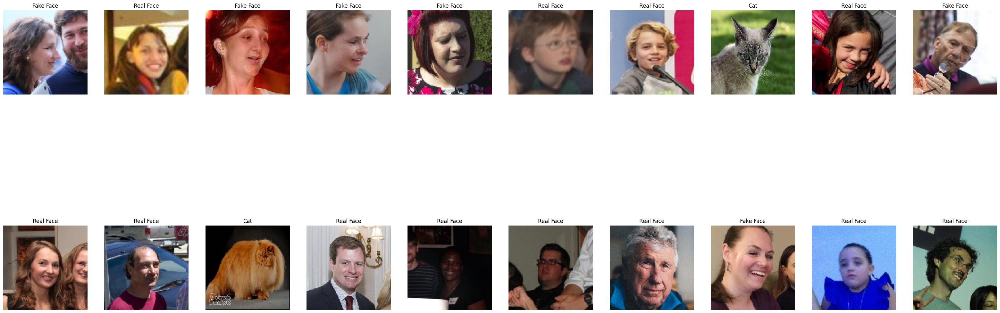

In [82]:
# Show some of the Adversarial Examples

plt.figure(figsize=(40, 16))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_train_pixel[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_train[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_train[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [83]:
# Save the perturbed images
# Base directory where the images will be saved
base_dir = './adversarial_examples_pa'

# Ensure the base directory exists
os.makedirs(base_dir, exist_ok=True)

# Sub-directories for each category based on your model's classes
# Adjust these as necessary based on your specific class names or structure
sub_dirs = {0: 'real', 1: 'fake', 2: 'cat'}

# Create subdirectories for each class if they don't already exist
for sub_dir in sub_dirs.values():
    os.makedirs(os.path.join(base_dir, sub_dir), exist_ok=True)

# Iterate through each adversarial example and its corresponding target label
for i, (image, label) in enumerate(zip(X_train_pixel, y_train[:9483])):
    # Determine the target class for this image based on the one-hot encoded label
    target_class = np.argmax(label)
    # Convert image from normalized 0-1 to 0-255 if necessary
    image_rescaled = (image * 255).astype(np.uint8)
    # Define the path where the image will be saved
    image_path = os.path.join(base_dir, sub_dirs[target_class], f'adv_example_{i+1}.png')
    # Save the image
    save_img(image_path, image_rescaled)

print(f"Adversarial examples saved in: {base_dir}")

Adversarial examples saved in: ./adversarial_examples_pa


In [ ]:
# Save the perturbed images
# Base directory where the images will be saved
base_dir = './adversarial_examples_pa_test'

# Ensure the base directory exists
os.makedirs(base_dir, exist_ok=True)

# Sub-directories for each category based on your model's classes
# Adjust these as necessary based on your specific class names or structure
sub_dirs = {0: 'real', 1: 'fake', 2: 'cat'}

# Create subdirectories for each class if they don't already exist
for sub_dir in sub_dirs.values():
    os.makedirs(os.path.join(base_dir, sub_dir), exist_ok=True)

# Iterate through each adversarial example and its corresponding target label
for i, (image, label) in enumerate(zip(X_test_pixel, y_test)):
    # Determine the target class for this image based on the one-hot encoded label
    target_class = np.argmax(label)
    # Convert image from normalized 0-1 to 0-255 if necessary
    image_rescaled = (image * 255).astype(np.uint8)
    # Define the path where the image will be saved
    image_path = os.path.join(base_dir, sub_dirs[target_class], f'adv_example_{i+1}.png')
    # Save the image
    save_img(image_path, image_rescaled)

print(f"Adversarial examples saved in: {base_dir}")

#### GeoDA Attack

In [5]:
# Import the GeoDA attack
from art.attacks.evasion import GeoDA

In [11]:
# Create the classifier
g_classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=3,  # Adjust based on your model
    input_shape=X_test[0].shape,  # Adjust based on your model
    clip_values=(0, 1),
    loss_object=tf.keras.losses.CategoricalCrossentropy()
)
g_attack = GeoDA(
    estimator=g_classifier,
    batch_size=128,
    norm=2,
    sub_dim=10,
    max_iter=4000,  # Default value for a comprehensive test
    bin_search_tol=0.1,
    lambda_param=0.6,
    sigma=0.002,
    verbose=True
)


In [88]:
y_test_real_face = np.zeros((len(X_test), 3))  # Initialize with zeros for 3 classes
y_test_real_face[:, 0] = 1  # Set the first class (Real Face) to 1 for all instances


In [ ]:
# Generate the samples
X_test_geo = g_attack.generate(x=X_test, y=y_test_real_face)

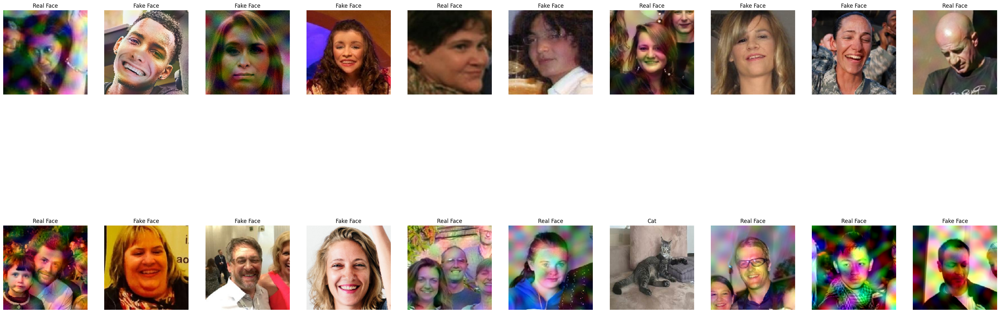

In [90]:
# Show some of the Adversarial Examples
plt.figure(figsize=(40, 16))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_test_geo[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_test[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_test[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [91]:
import os
import numpy as np
from tensorflow.keras.preprocessing.image import save_img

# Assuming `y_test` is one-hot encoded and `X_test_pixel` represents the images in pixel format

# Create a directory for the adversarial examples if it doesn't exist
save_dir_base = "./geo_images_random"
os.makedirs(save_dir_base, exist_ok=True)

# Directories for each label
label_dirs = ['real', 'fake', 'cat']
for label_dir in label_dirs:
    os.makedirs(os.path.join(save_dir_base, label_dir), exist_ok=True)

# Filter and randomly select 25 indices for each label
# Adjust these lines for one-hot encoded labels
indices_real = np.where(np.argmax(y_test, axis=1) == 0)[0]
indices_fake = np.where(np.argmax(y_test, axis=1) == 1)[0]
indices_cat = np.where(np.argmax(y_test, axis=1) == 2)[0]

selected_indices_real = np.random.choice(indices_real, 25, replace=False)
selected_indices_fake = np.random.choice(indices_fake, 25, replace=False)
selected_indices_cat = np.random.choice(indices_cat, 25, replace=False)

# Define a function to save images based on their indices and label directory
def save_images(indices, label_dir):
    for i, idx in enumerate(indices):
        image_path = os.path.join(save_dir_base, label_dir, f"{label_dir}_example_{i+1}.png")
        img_to_save = (X_test_geo[idx] * 255).astype('uint8')  # Rescale if needed
        save_img(image_path, img_to_save)

# Save the images for each label
save_images(selected_indices_real, 'real')
save_images(selected_indices_fake, 'fake')
save_images(selected_indices_cat, 'cat')

print(f"Saved adversarial examples in: {save_dir_base}")

Saved adversarial examples in: ./geo_images_random


In [92]:
# Save the perturbed images
# Base directory where the images will be saved
base_dir = './adversarial_examples_geo_test'

# Ensure the base directory exists
os.makedirs(base_dir, exist_ok=True)

# Sub-directories for each category based on your model's classes
# Adjust these as necessary based on your specific class names or structure
sub_dirs = {0: 'real', 1: 'fake', 2: 'cat'}

# Create subdirectories for each class if they don't already exist
for sub_dir in sub_dirs.values():
    os.makedirs(os.path.join(base_dir, sub_dir), exist_ok=True)

# Iterate through each adversarial example and its corresponding target label
for i, (image, label) in enumerate(zip(X_test_geo, y_test)):
    # Determine the target class for this image based on the one-hot encoded label
    target_class = np.argmax(label)
    # Convert image from normalized 0-1 to 0-255 if necessary
    image_rescaled = (image * 255).astype(np.uint8)
    # Define the path where the image will be saved
    image_path = os.path.join(base_dir, sub_dirs[target_class], f'adv_example_{i+1}.png')
    # Save the image
    save_img(image_path, image_rescaled)

print(f"Adversarial examples saved in: {base_dir}")

Adversarial examples saved in: ./adversarial_examples_geo_test


##### My model

In [93]:
evaluation_result = model.evaluate(
    x=X_test_geo,
    y=y_test
)

149/149 [==============================] - 2s 9ms/step - loss: 0.6672 - accuracy: 0.5127


149/149 [==============================] - 1s 5ms/step


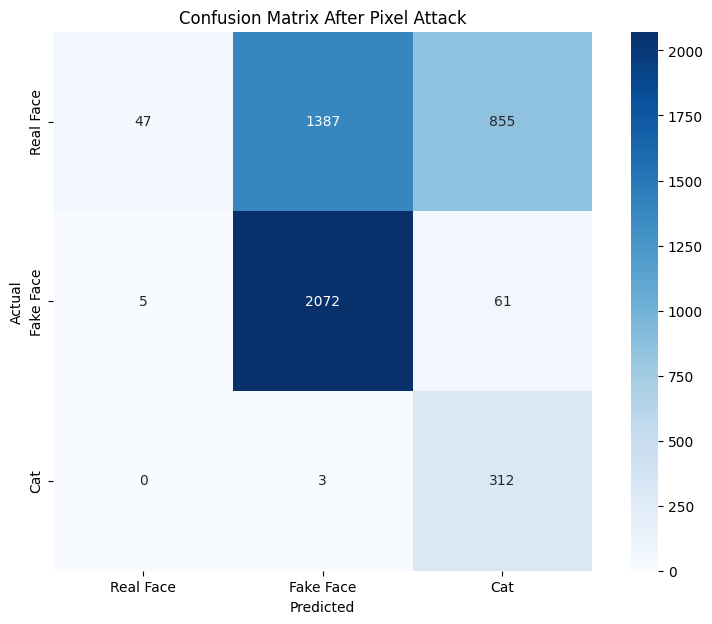

In [94]:
# Test it on my model
y_pred = model.predict(X_test_geo)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix After Geo Attack')
plt.show()

In [7]:
y_train_real_face = np.zeros((len(X_train), 3))  # Initialize with zeros for 3 classes
y_train_real_face[:, 0] = 1  # Set the first class (Real Face) to 1 for all instances

In [ ]:
# Create Training dataset
X_train_geo = g_attack.generate(x=X_train[:9483],y=y_train_real_face[:9483])

In [14]:
import os
import numpy as np
from tensorflow.keras.preprocessing.image import save_img
# Save the perturbed images
# Base directory where the images will be saved
base_dir = './adversarial_examples_geo'

# Ensure the base directory exists
os.makedirs(base_dir, exist_ok=True)

# Sub-directories for each category based on your model's classes
# Adjust these as necessary based on your specific class names or structure
sub_dirs = {0: 'real', 1: 'fake', 2: 'cat'}

# Create subdirectories for each class if they don't already exist
for sub_dir in sub_dirs.values():
    os.makedirs(os.path.join(base_dir, sub_dir), exist_ok=True)

# Iterate through each adversarial example and its corresponding target label
for i, (image, label) in enumerate(zip(X_train_geo, y_train[:9483])):
    # Determine the target class for this image based on the one-hot encoded label
    target_class = np.argmax(label)
    # Convert image from normalized 0-1 to 0-255 if necessary
    image_rescaled = (image * 255).astype(np.uint8)
    # Define the path where the image will be saved
    image_path = os.path.join(base_dir, sub_dirs[target_class], f'adv_example_{i+1}.png')
    # Save the image
    save_img(image_path, image_rescaled)

print(f"Adversarial examples saved in: {base_dir}")

Adversarial examples saved in: ./adversarial_examples_geo


#### VS ChatGPTV, Gemini, and Ollama LLAVA

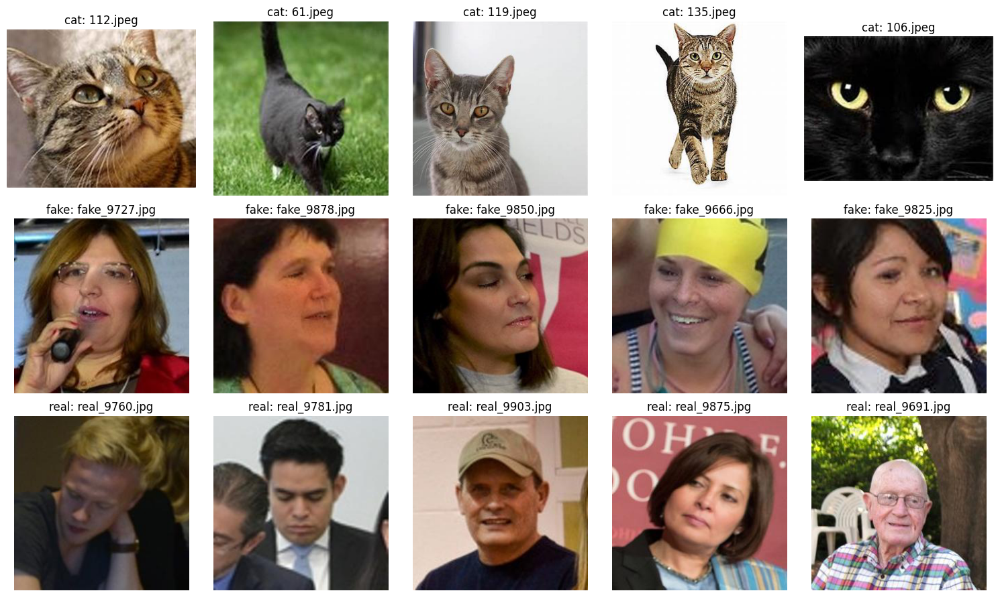

In [1]:
# Images to be classified
# Normal

import matplotlib.pyplot as plt
import os
from PIL import Image


def display_images_from_folder(base_path):
    categories = ['cat', 'fake', 'real']
    fig, axs = plt.subplots(nrows=3, ncols=5, figsize=(15, 9))
    for i, category in enumerate(categories):
        image_folder = os.path.join(base_path, category)
        images = os.listdir(image_folder)[:5]  # Display the first 5 images
        for j, img in enumerate(images):
            img_path = os.path.join(image_folder, img)
            img = Image.open(img_path)
            axs[i, j].imshow(img)
            axs[i, j].set_title(f"{category}: {img.filename.split('/')[-1]}")
            axs[i, j].axis('off')
    plt.tight_layout()
    plt.show()


# Path to the normal images directory
normal_images_path = 'images/normal'
display_images_from_folder(normal_images_path)

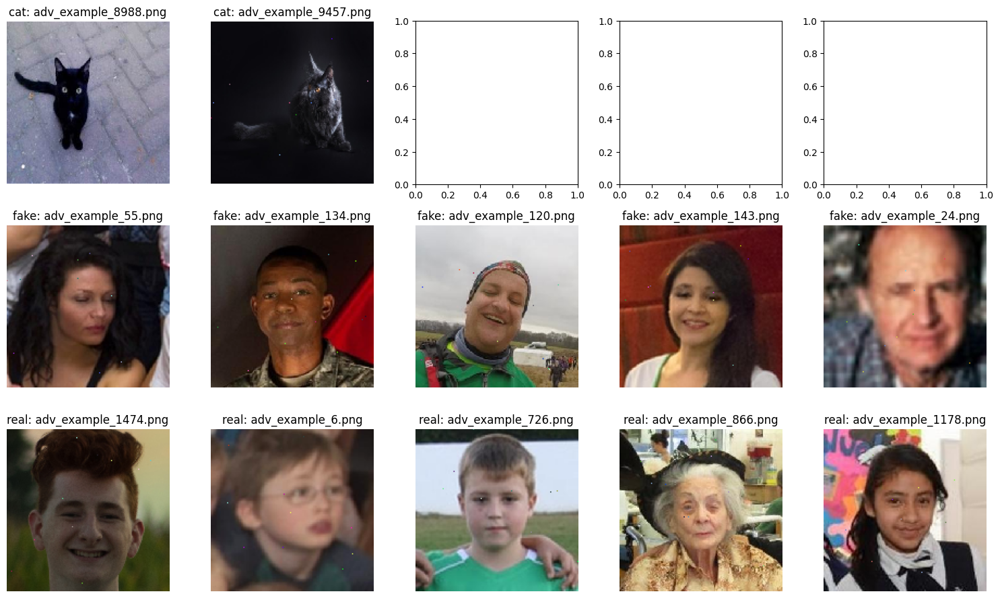

In [2]:
# Pixel Attack
import matplotlib.pyplot as plt
import os
from PIL import Image


def display_images_from_folder(base_path):
    categories = ['cat', 'fake', 'real']
    fig, axs = plt.subplots(nrows=3, ncols=5, figsize=(15, 9))
    for i, category in enumerate(categories):
        image_folder = os.path.join(base_path, category)
        images = os.listdir(image_folder)[:5]  # Adjust number if fewer images
        for j, img in enumerate(images):
            img_path = os.path.join(image_folder, img)
            img = Image.open(img_path)
            axs[i, j].imshow(img)
            axs[i, j].set_title(f"{category}: {img.filename.split('/')[-1]}")
            axs[i, j].axis('off')
    plt.tight_layout()
    plt.show()


# Path to the pa images directory
pa_images_path = 'images/pa'
display_images_from_folder(pa_images_path)

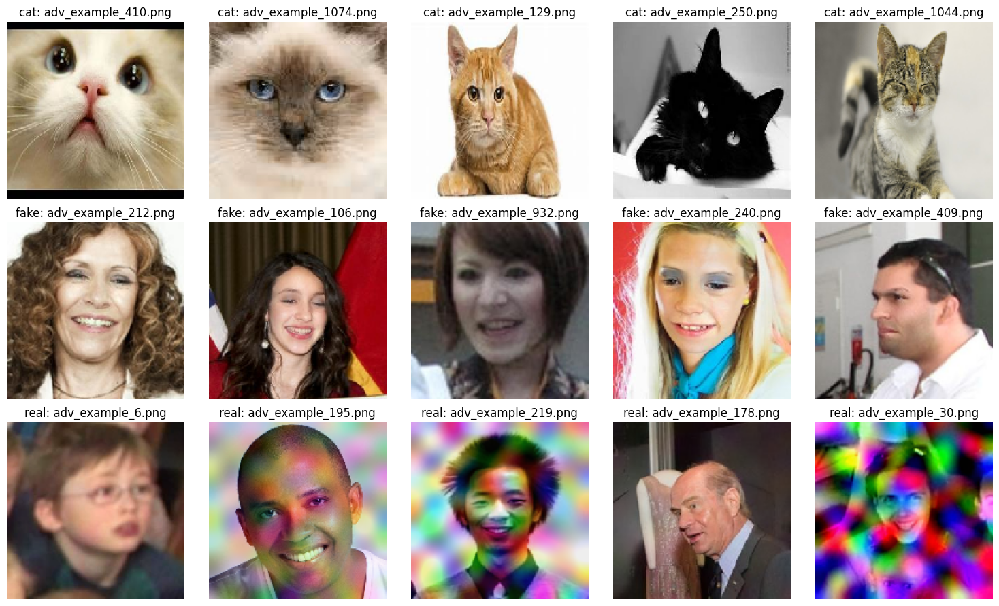

In [3]:
# Geo
import matplotlib.pyplot as plt
import os
from PIL import Image


def display_images_from_folder(base_path):
    categories = ['cat', 'fake', 'real']
    fig, axs = plt.subplots(nrows=3, ncols=5, figsize=(15, 9))
    for i, category in enumerate(categories):
        image_folder = os.path.join(base_path, category)
        images = os.listdir(image_folder)[:5]  # Display the first 5 images
        for j, img in enumerate(images):
            img_path = os.path.join(image_folder, img)
            img = Image.open(img_path)
            axs[i, j].imshow(img)
            axs[i, j].set_title(f"{category}: {img.filename.split('/')[-1]}")
            axs[i, j].axis('off')
    plt.tight_layout()
    plt.show()


# Path to the geo images directory
geo_images_path = 'images/geo'
display_images_from_folder(geo_images_path)

##### GTPV

In [14]:
# Initial Setup
import base64
import requests
import os
from dotenv import load_dotenv

# Load API key from .env file
load_dotenv()
api_key = os.getenv("OPENAI_API_KEY")


def encode_image(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')


def get_image_paths(base_dir, categories):
    paths = []
    for category in categories:
        full_path = os.path.join(base_dir, category)
        for image in os.listdir(full_path):
            paths.append((os.path.join(full_path, image), category))
    return paths


headers = {
    "Content-Type": "application/json",
    "Authorization": f"Bearer {api_key}"
}

In [20]:
# Normal images before attacks
base_dir_normal = 'images/normal'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    base64_image = encode_image(path)
    payload = {
        "model": "gpt-4-turbo",
        "messages": [
            {
                "role": "user",
                "content": [
                    {
                        "type": "text",
                        "text": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\". Do not include any other punctuation."
                    },
                    {
                        "type": "image_url",
                        "image_url": {
                            "url": f"data:image/jpeg;base64,{base64_image}"
                        }
                    }
                ]
            }
        ],
        "max_tokens": 300
    }
    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    prediction = response.json()['choices'][0]['message']['content'].strip().capitalize()
    print(f"{path} is {prediction}")
    if prediction.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'normal' images: {accuracy:.2f}")


images/normal/cat/112.jpeg is Cat
images/normal/cat/61.jpeg is Cat
images/normal/cat/119.jpeg is Cat
images/normal/cat/135.jpeg is Cat
images/normal/cat/106.jpeg is Cat
images/normal/fake/fake_9727.jpg is Real
images/normal/fake/fake_9878.jpg is Real
images/normal/fake/fake_9850.jpg is Real
images/normal/fake/fake_9666.jpg is Real
images/normal/fake/fake_9825.jpg is Real
images/normal/real/real_9760.jpg is Real
images/normal/real/real_9781.jpg is Real
images/normal/real/real_9903.jpg is Real
images/normal/real/real_9875.jpg is Real
images/normal/real/real_9691.jpg is Real
Accuracy for 'normal' images: 0.67


In [21]:
# Pixel Attack images
base_dir_normal = 'images/pa'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    base64_image = encode_image(path)
    payload = {
        "model": "gpt-4-turbo",
        "messages": [
            {
                "role": "user",
                "content": [
                    {
                        "type": "text",
                        "text": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\". Do not include any other punctuation."
                    },
                    {
                        "type": "image_url",
                        "image_url": {
                            "url": f"data:image/jpeg;base64,{base64_image}"
                        }
                    }
                ]
            }
        ],
        "max_tokens": 300
    }
    response = requests.post(
        "https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    prediction = response.json(
    )['choices'][0]['message']['content'].strip().capitalize()
    print(f"{path} is {prediction}")
    if prediction.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'Pixel Attack' images: {accuracy:.2f}")

images/pa/cat/adv_example_8988.png is Cat
images/pa/cat/adv_example_9457.png is Cat
images/pa/fake/adv_example_55.png is Real
images/pa/fake/adv_example_134.png is Real
images/pa/fake/adv_example_120.png is Real
images/pa/fake/adv_example_143.png is Real
images/pa/fake/adv_example_24.png is Real
images/pa/real/adv_example_1474.png is Real
images/pa/real/adv_example_6.png is Real
images/pa/real/adv_example_726.png is Real
images/pa/real/adv_example_866.png is Real
images/pa/real/adv_example_1178.png is Real
Accuracy for 'Pixel Attack' images: 0.58


In [22]:
# GeoDA Attack images
base_dir_normal = 'images/geo'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    base64_image = encode_image(path)
    payload = {
        "model": "gpt-4-turbo",
        "messages": [
            {
                "role": "user",
                "content": [
                    {
                        "type": "text",
                        "text": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\". Do not include any other punctuation."
                    },
                    {
                        "type": "image_url",
                        "image_url": {
                            "url": f"data:image/jpeg;base64,{base64_image}"
                        }
                    }
                ]
            }
        ],
        "max_tokens": 300
    }
    response = requests.post(
        "https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    prediction = response.json(
    )['choices'][0]['message']['content'].strip().capitalize()
    print(f"{path} is {prediction}")
    if prediction.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'GeoDa Attack' images: {accuracy:.2f}")

images/geo/cat/adv_example_410.png is Cat
images/geo/cat/adv_example_1074.png is Cat
images/geo/cat/adv_example_129.png is Cat
images/geo/cat/adv_example_250.png is Cat
images/geo/cat/adv_example_1044.png is Cat
images/geo/fake/adv_example_212.png is Real
images/geo/fake/adv_example_106.png is Real
images/geo/fake/adv_example_932.png is Real
images/geo/fake/adv_example_240.png is Real
images/geo/fake/adv_example_409.png is Real
images/geo/real/adv_example_6.png is Real
images/geo/real/adv_example_195.png is Real
images/geo/real/adv_example_219.png is Fake
images/geo/real/adv_example_178.png is Real
images/geo/real/adv_example_30.png is Fake
Accuracy for 'GeoDa Attack' images: 0.53


##### Gemini Pro Vision

In [5]:
# Base imports
import requests
import google.generativeai as genai
import os
from IPython.display import Markdown
from dotenv import load_dotenv
import time

# Load API key from .env file
load_dotenv()
google_api_key = os.getenv("GOOGLE_API_KEY")
genai.configure(api_key=google_api_key)

In [8]:
# Directory for normal images
normal_images_dir = 'images/normal'
categories = ['cat', 'fake', 'real']
total_normal = 0
correct_normal = 0

generation_config = {
  "temperature": 1,
  "top_p": 0.95,
  "top_k": 0,
  "max_output_tokens": 8192,
}

safety_settings = [
  {
    "category": "HARM_CATEGORY_HARASSMENT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_HATE_SPEECH",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_SEXUALLY_EXPLICIT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_DANGEROUS_CONTENT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
]

model = genai.GenerativeModel(model_name="gemini-1.5-pro-latest",
                              generation_config=generation_config,
                              safety_settings=safety_settings)

for category in categories:
    path = os.path.join(normal_images_dir, category)
    for image in os.listdir(path):
        filename = os.path.join(path, image)
        display_name = f"normal{category}_{image.split('.')[0]}"
        
        # Upload the file
        uploaded_file = genai.upload_file(path=filename,
                                                     display_name=display_name)
        #print(f"Uploaded file '{uploaded_file.display_name}' as: {uploaded_file.uri}")

        # Generate content
        response = model.generate_content(
            ["Is this picture of a real face, a fake ai generated (or photoshopped) face, or a cat? In your response, only respond with 'real', 'fake', or 'cat'. Do not include any other punctuation.", uploaded_file])

        predicted_label = response.text.strip().lower()
        print(f"{filename} is predicted as: {predicted_label}")
        time.sleep(20)
        # Check prediction accuracy
        if predicted_label == category:
            correct_normal += 1
        total_normal += 1

accuracy_normal = correct_normal / total_normal
print(f"Accuracy for 'normal' images: {accuracy_normal:.2f}")

images/normal\cat\106.jpeg is predicted as: cat
images/normal\cat\112.jpeg is predicted as: cat
images/normal\cat\119.jpeg is predicted as: cat
images/normal\cat\135.jpeg is predicted as: cat
images/normal\cat\61.jpeg is predicted as: cat
images/normal\fake\fake_9666.jpg is predicted as: real
images/normal\fake\fake_9727.jpg is predicted as: real
images/normal\fake\fake_9825.jpg is predicted as: real
images/normal\fake\fake_9850.jpg is predicted as: real
images/normal\fake\fake_9878.jpg is predicted as: real
images/normal\real\real_9691.jpg is predicted as: real
images/normal\real\real_9760.jpg is predicted as: real
images/normal\real\real_9781.jpg is predicted as: real
images/normal\real\real_9875.jpg is predicted as: real
images/normal\real\real_9903.jpg is predicted as: real
Accuracy for 'normal' images: 0.67


In [9]:
# Directory for pa images
pa_images_dir = 'images/pa'
total_pa = 0
correct_pa = 0

generation_config = {
  "temperature": 1,
  "top_p": 0.95,
  "top_k": 0,
  "max_output_tokens": 8192,
}

safety_settings = [
  {
    "category": "HARM_CATEGORY_HARASSMENT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_HATE_SPEECH",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_SEXUALLY_EXPLICIT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_DANGEROUS_CONTENT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
]

model = genai.GenerativeModel(model_name="gemini-1.5-pro-latest",
                              generation_config=generation_config,
                              safety_settings=safety_settings)

for category in categories:
    path = os.path.join(pa_images_dir, category)
    for image in os.listdir(path):
        filename = os.path.join(path, image)
        display_name = f"pa{category}_{image.split('.')[0]}"

        # Upload the file
        uploaded_file = genai.upload_file(path=filename,
                                                     display_name=display_name)
        #print(f"Uploaded file '{uploaded_file.display_name}' as: {uploaded_file.uri}")

        # Generate content
        response = model.generate_content(
            ["Is this picture of a real face, a fake ai generated (or photoshopped) face, or a cat? In your response, only respond with 'real', 'fake', or 'cat'. Do not include any other punctuation.", uploaded_file])

        predicted_label = response.text.strip().lower()
        print(f"{filename} is predicted as: {predicted_label}")
        time.sleep(20)
        # Check prediction accuracy
        if predicted_label == category:
            correct_pa += 1
        total_pa += 1

accuracy_pa = correct_pa / total_pa
print(f"Accuracy for 'pa' images: {accuracy_pa:.2f}")

images/pa\cat\adv_example_8988.png is predicted as: cat
images/pa\cat\adv_example_9457.png is predicted as: cat
images/pa\fake\adv_example_120.png is predicted as: real
images/pa\fake\adv_example_134.png is predicted as: real
images/pa\fake\adv_example_143.png is predicted as: real
images/pa\fake\adv_example_24.png is predicted as: real
images/pa\fake\adv_example_55.png is predicted as: real
images/pa\real\adv_example_1178.png is predicted as: real
images/pa\real\adv_example_1474.png is predicted as: real
images/pa\real\adv_example_6.png is predicted as: real
images/pa\real\adv_example_726.png is predicted as: real
images/pa\real\adv_example_866.png is predicted as: real
Accuracy for 'pa' images: 0.58


In [10]:
# Directory for geo images
geo_images_dir = 'images/geo'
total_geo = 0
correct_geo = 0

generation_config = {
  "temperature": 1,
  "top_p": 0.95,
  "top_k": 0,
  "max_output_tokens": 8192,
}

safety_settings = [
  {
    "category": "HARM_CATEGORY_HARASSMENT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_HATE_SPEECH",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_SEXUALLY_EXPLICIT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
  {
    "category": "HARM_CATEGORY_DANGEROUS_CONTENT",
    "threshold": "BLOCK_MEDIUM_AND_ABOVE"
  },
]

model = genai.GenerativeModel(model_name="gemini-1.5-pro-latest",
                              generation_config=generation_config,
                              safety_settings=safety_settings)

for category in categories:
    path = os.path.join(geo_images_dir, category)
    for image in os.listdir(path):
        filename = os.path.join(path, image)
        display_name = f"geo{category}_{image.split('.')[0]}"

        # Upload the file
        uploaded_file = genai.upload_file(path=filename,
                                                     display_name=display_name)
        #print(f"Uploaded file '{uploaded_file.display_name}' as: {uploaded_file.uri}")

        # Generate content
        response = model.generate_content(
            ["Is this picture of a real face, a fake ai generated (or photoshopped) face, or a cat? In your response, only respond with 'real', 'fake', or 'cat'. Do not include any other punctuation.", uploaded_file])

        predicted_label = response.text.strip().lower()
        print(f"{filename} is predicted as: {predicted_label}")
        time.sleep(20)
        # Check prediction accuracy
        if predicted_label == category:
            correct_geo += 1
        total_geo += 1

accuracy_geo = correct_geo / total_geo
print(f"Accuracy for 'geo' images: {accuracy_geo:.2f}")

images/geo\cat\adv_example_1044.png is predicted as: cat
images/geo\cat\adv_example_1074.png is predicted as: cat
images/geo\cat\adv_example_129.png is predicted as: cat
images/geo\cat\adv_example_250.png is predicted as: cat
images/geo\cat\adv_example_410.png is predicted as: cat
images/geo\fake\adv_example_106.png is predicted as: real
images/geo\fake\adv_example_212.png is predicted as: real
images/geo\fake\adv_example_240.png is predicted as: real
images/geo\fake\adv_example_409.png is predicted as: fake
images/geo\fake\adv_example_932.png is predicted as: real
images/geo\real\adv_example_178.png is predicted as: real
images/geo\real\adv_example_195.png is predicted as: fake
images/geo\real\adv_example_219.png is predicted as: real
images/geo\real\adv_example_30.png is predicted as: real
images/geo\real\adv_example_6.png is predicted as: real
Accuracy for 'geo' images: 0.67


##### ollama llava 7b

In [10]:
# Images before attacks
import requests
import base64
import os

def encode_image_to_base64(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')

def get_image_paths(base_dir, categories):
    paths = []
    for category in categories:
        full_path = os.path.join(base_dir, category)
        for image in os.listdir(full_path):
            paths.append((os.path.join(full_path, image), category))
    return paths

base_dir_normal = 'images/normal'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    encoded_image = encode_image_to_base64(path)
    data = {
        "model": "llava",
        "prompt": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\".",
        "stream": False,
        "images": [encoded_image]
    }
    response = requests.post('http://localhost:11434/api/generate', json=data)
    predicted_label = response.json()['response'].strip()
    print(f"{path} is {predicted_label}")
    if predicted_label.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'normal' images: {accuracy:.2f}")


images/normal/cat/112.jpeg is Cat
images/normal/cat/61.jpeg is Cat
images/normal/cat/119.jpeg is Cat
images/normal/cat/135.jpeg is Real
images/normal/cat/106.jpeg is Fake
images/normal/fake/fake_9727.jpg is Real
images/normal/fake/fake_9878.jpg is Real
images/normal/fake/fake_9850.jpg is Real
images/normal/fake/fake_9666.jpg is Fake
images/normal/fake/fake_9825.jpg is Real
images/normal/real/real_9760.jpg is Real
images/normal/real/real_9781.jpg is Real
images/normal/real/real_9903.jpg is Real
images/normal/real/real_9875.jpg is Real
images/normal/real/real_9691.jpg is Real
Accuracy for 'normal' images: 0.60


In [11]:
# Images with Pixel Attack
import requests
import base64
import os


def encode_image_to_base64(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')


def get_image_paths(base_dir, categories):
    paths = []
    for category in categories:
        full_path = os.path.join(base_dir, category)
        for image in os.listdir(full_path):
            paths.append((os.path.join(full_path, image), category))
    return paths


base_dir_normal = 'images/pa'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    encoded_image = encode_image_to_base64(path)
    data = {
        "model": "llava",
        "prompt": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\".",
        "stream": False,
        "images": [encoded_image]
    }
    response = requests.post('http://localhost:11434/api/generate', json=data)
    predicted_label = response.json()['response'].strip()
    print(f"{path} is {predicted_label}")
    if predicted_label.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'Pixel Attack' images: {accuracy:.2f}")

images/pa/cat/adv_example_8988.png is Cat
images/pa/cat/adv_example_9457.png is Fake
images/pa/fake/adv_example_55.png is Real
images/pa/fake/adv_example_134.png is Real
images/pa/fake/adv_example_120.png is Fake
images/pa/fake/adv_example_143.png is Real
images/pa/fake/adv_example_24.png is Real
images/pa/real/adv_example_1474.png is Real
images/pa/real/adv_example_6.png is Real
images/pa/real/adv_example_726.png is Fake
images/pa/real/adv_example_866.png is Fake
images/pa/real/adv_example_1178.png is Real
Accuracy for 'Pixel Attack' images: 0.42


In [12]:
# Images on GeoDA Attack
import requests
import base64
import os


def encode_image_to_base64(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')


def get_image_paths(base_dir, categories):
    paths = []
    for category in categories:
        full_path = os.path.join(base_dir, category)
        for image in os.listdir(full_path):
            paths.append((os.path.join(full_path, image), category))
    return paths


base_dir_normal = 'images/geo'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    encoded_image = encode_image_to_base64(path)
    data = {
        "model": "llava",
        "prompt": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\".",
        "stream": False,
        "images": [encoded_image]
    }
    response = requests.post('http://localhost:11434/api/generate', json=data)
    predicted_label = response.json()['response'].strip()
    print(f"{path} is {predicted_label}")
    if predicted_label.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'GeoDA Attack' images: {accuracy:.2f}")

images/geo/cat/adv_example_410.png is Cat
images/geo/cat/adv_example_1074.png is Cat
images/geo/cat/adv_example_129.png is Fake
images/geo/cat/adv_example_250.png is Cat
images/geo/cat/adv_example_1044.png is Fake
images/geo/fake/adv_example_212.png is Fake
images/geo/fake/adv_example_106.png is Real
images/geo/fake/adv_example_932.png is Real
images/geo/fake/adv_example_240.png is Fake
images/geo/fake/adv_example_409.png is Real
images/geo/real/adv_example_6.png is Real
images/geo/real/adv_example_195.png is Fake
images/geo/real/adv_example_219.png is Real
images/geo/real/adv_example_178.png is Real
images/geo/real/adv_example_30.png is Fake
Accuracy for 'GeoDA Attack' images: 0.53


##### Ollama Llava 34B

In [12]:
# Images before attacks
import requests
import base64
import os

def encode_image_to_base64(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')

def get_image_paths(base_dir, categories):
    paths = []
    for category in categories:
        full_path = os.path.join(base_dir, category)
        for image in os.listdir(full_path):
            paths.append((os.path.join(full_path, image), category))
    return paths

base_dir_normal = 'images/normal'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    encoded_image = encode_image_to_base64(path)
    data = {
        "model": "llava:34b",
        "prompt": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\". Do not use any other punctuation.",
        "stream": False,
        "images": [encoded_image]
    }
    response = requests.post('http://localhost:11434/api/generate', json=data)
    predicted_label = response.json()['response'].strip()
    print(f"{path} is {predicted_label}")
    if predicted_label.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'normal' images: {accuracy:.2f}")


images/normal\cat\106.jpeg is Cat
images/normal\cat\112.jpeg is Cat
images/normal\cat\119.jpeg is Cat
images/normal\cat\135.jpeg is Cat
images/normal\cat\61.jpeg is Cat
images/normal\fake\fake_9666.jpg is Real
images/normal\fake\fake_9727.jpg is Real
images/normal\fake\fake_9825.jpg is Real
images/normal\fake\fake_9850.jpg is Real
images/normal\fake\fake_9878.jpg is real
images/normal\real\real_9691.jpg is Real
images/normal\real\real_9760.jpg is Real
images/normal\real\real_9781.jpg is Real
images/normal\real\real_9875.jpg is Real
images/normal\real\real_9903.jpg is real
Accuracy for 'normal' images: 0.67


In [13]:
# Images with Pixel Attack
import requests
import base64
import os


def encode_image_to_base64(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')


def get_image_paths(base_dir, categories):
    paths = []
    for category in categories:
        full_path = os.path.join(base_dir, category)
        for image in os.listdir(full_path):
            paths.append((os.path.join(full_path, image), category))
    return paths


base_dir_normal = 'images/pa'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    encoded_image = encode_image_to_base64(path)
    data = {
        "model": "llava:34b",
        "prompt": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\". Do not use any other punctuation.",
        "stream": False,
        "images": [encoded_image]
    }
    response = requests.post('http://localhost:11434/api/generate', json=data)
    predicted_label = response.json()['response'].strip()
    print(f"{path} is {predicted_label}")
    if predicted_label.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'Pixel Attack' images: {accuracy:.2f}")

images/pa\cat\adv_example_8988.png is Cat
images/pa\cat\adv_example_9457.png is Fake
images/pa\fake\adv_example_120.png is real
images/pa\fake\adv_example_134.png is Real
images/pa\fake\adv_example_143.png is Real
images/pa\fake\adv_example_24.png is Real
images/pa\fake\adv_example_55.png is real
images/pa\real\adv_example_1178.png is Real
images/pa\real\adv_example_1474.png is Real
images/pa\real\adv_example_6.png is Real
images/pa\real\adv_example_726.png is Real
images/pa\real\adv_example_866.png is Real
Accuracy for 'Pixel Attack' images: 0.50


In [14]:
# Images on GeoDA Attack
import requests
import base64
import os


def encode_image_to_base64(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')


def get_image_paths(base_dir, categories):
    paths = []
    for category in categories:
        full_path = os.path.join(base_dir, category)
        for image in os.listdir(full_path):
            paths.append((os.path.join(full_path, image), category))
    return paths


base_dir_normal = 'images/geo'
categories = ['cat', 'fake', 'real']
image_paths_normal = get_image_paths(base_dir_normal, categories)

correct = 0
total = len(image_paths_normal)

for path, true_label in image_paths_normal:
    encoded_image = encode_image_to_base64(path)
    data = {
        "model": "llava:34b",
        "prompt": "Is this picture of a real face, a fake face, or a cat? In your response, only respond with \"real\", \"fake\", or \"cat\". Do not use any other punctuation.",
        "stream": False,
        "images": [encoded_image]
    }
    response = requests.post('http://localhost:11434/api/generate', json=data)
    predicted_label = response.json()['response'].strip()
    print(f"{path} is {predicted_label}")
    if predicted_label.lower() == true_label:
        correct += 1

accuracy = correct / total
print(f"Accuracy for 'GeoDA Attack' images: {accuracy:.2f}")

images/geo\cat\adv_example_1044.png is Cat
images/geo\cat\adv_example_1074.png is Cat
images/geo\cat\adv_example_129.png is Cat
images/geo\cat\adv_example_250.png is Cat
images/geo\cat\adv_example_410.png is Cat
images/geo\fake\adv_example_106.png is real
images/geo\fake\adv_example_212.png is Real
images/geo\fake\adv_example_240.png is real
images/geo\fake\adv_example_409.png is real
images/geo\fake\adv_example_932.png is real
images/geo\real\adv_example_178.png is Real
images/geo\real\adv_example_195.png is Real
images/geo\real\adv_example_219.png is Real
images/geo\real\adv_example_30.png is Real
images/geo\real\adv_example_6.png is Real
Accuracy for 'GeoDA Attack' images: 0.67


### Training my model on Adversarial data

#### Training on Pixel Attack

In [2]:
def load_dataset(folder_paths, test_size=0.2, limiter=5000):
    X = []
    y = []
    # Update the dictionary to include the new category
    label_map = {'real': 0, 'fake': 1, 'cat': 2}
    
    for folder_path in folder_paths:
        # Determine the label from the folder name
        if 'real' in folder_path:
            label = label_map['real']
        elif 'fake' in folder_path:
            label = label_map['fake']
        elif 'cat' in folder_path:
            label = label_map['cat']
        else:
            continue  # Skip if the folder does not match any category

        files = os.listdir(folder_path)
        for filename in tqdm(files[:limiter], desc=f"Loading {folder_path}"):
            img = load_img(os.path.join(folder_path, filename), target_size=(150, 150))
            img_array = img_to_array(img)
            X.append(img_array)
            y.append(label)

    X = np.array(X)
    y = np.array(y)
    # Apply one-hot encoding to the labels
    y = to_categorical(y, num_classes=len(label_map))

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=42)
    return (X_train, y_train), (X_test, y_test)


# Paths to folders containing images:
folder_paths = [
    r"./face/real",
    r"./face/fake",
    r"./deep_fake_faces/Dataset/Train/real",
    r"./deep_fake_faces/Dataset/Train/fake",
    r"./cat",
    r"adversarial_examples_pa/real",
    r"adversarial_examples_pa/fake",
    r"adversarial_examples_pa/cat"
]

# Load dataset:
(X_train, y_train), (X_test, y_test) = load_dataset(folder_paths)
X_train = X_train / 255
X_test = X_test / 255

Loading adversarial_examples_pa/cat: 100%|███████████████████████████████████████████| 658/658 [00:02<00:00, 290.13it/s]


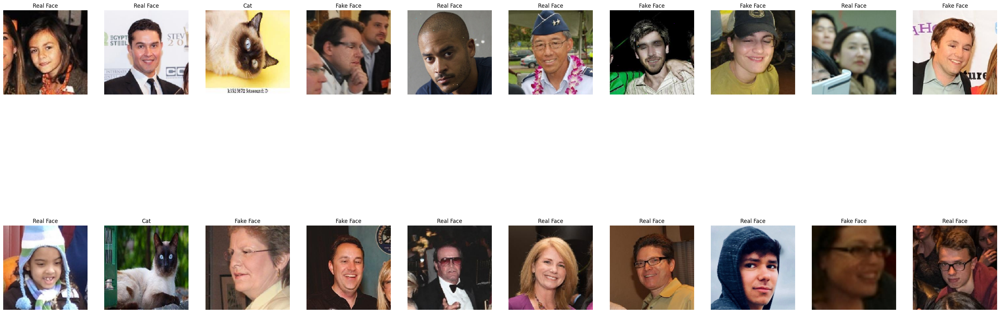

In [8]:
# Display the first 10 images:
plt.figure(figsize=(40, 16))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_test[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_test[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_test[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [15]:
def build_face_detector(input_shape=X_train[0].shape):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Flatten(),
        layers.Dense(256, activation='relu'),
        layers.Dense(512, activation='relu'),
        layers.Dense(3, activation='softmax')  # Modified to output 2 units for one-hot encoding
    ])

    model.compile(optimizer='adam',
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])

    return model

model = build_face_detector()
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 150, 150, 32)      896       
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 75, 75, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_5 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 37, 37, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_6 (Conv2D)           (None, 37, 37, 128)       73856     
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 18, 18, 128)      

In [16]:
# Training the model with validation data:
history = model.fit(
    x=X_train,
    y=y_train,
    epochs=10,
    batch_size=32,
    validation_data=(X_test, y_test)
)

2024-04-11 20:31:48.630567: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 5009310000 exceeds 10% of free system memory.
2024-04-11 20:31:53.261276: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 5009310000 exceeds 10% of free system memory.


Epoch 1/10
580/580 [==============================] - 11s 17ms/step - loss: 0.7128 - accuracy: 0.6152 - val_loss: 0.5246 - val_accuracy: 0.7379
Epoch 2/10
580/580 [==============================] - 7s 12ms/step - loss: 0.4807 - accuracy: 0.7625 - val_loss: 0.3869 - val_accuracy: 0.8239
Epoch 3/10
580/580 [==============================] - 7s 11ms/step - loss: 0.3458 - accuracy: 0.8420 - val_loss: 0.2852 - val_accuracy: 0.8692
Epoch 4/10
580/580 [==============================] - 7s 12ms/step - loss: 0.2607 - accuracy: 0.8819 - val_loss: 0.2491 - val_accuracy: 0.8862
Epoch 5/10
580/580 [==============================] - 7s 12ms/step - loss: 0.1998 - accuracy: 0.9118 - val_loss: 0.2597 - val_accuracy: 0.8901
Epoch 6/10
580/580 [==============================] - 7s 12ms/step - loss: 0.1461 - accuracy: 0.9374 - val_loss: 0.2601 - val_accuracy: 0.9004
Epoch 7/10
580/580 [==============================] - 7s 12ms/step - loss: 0.1079 - accuracy: 0.9583 - val_loss: 0.2824 - val_accuracy: 0.909

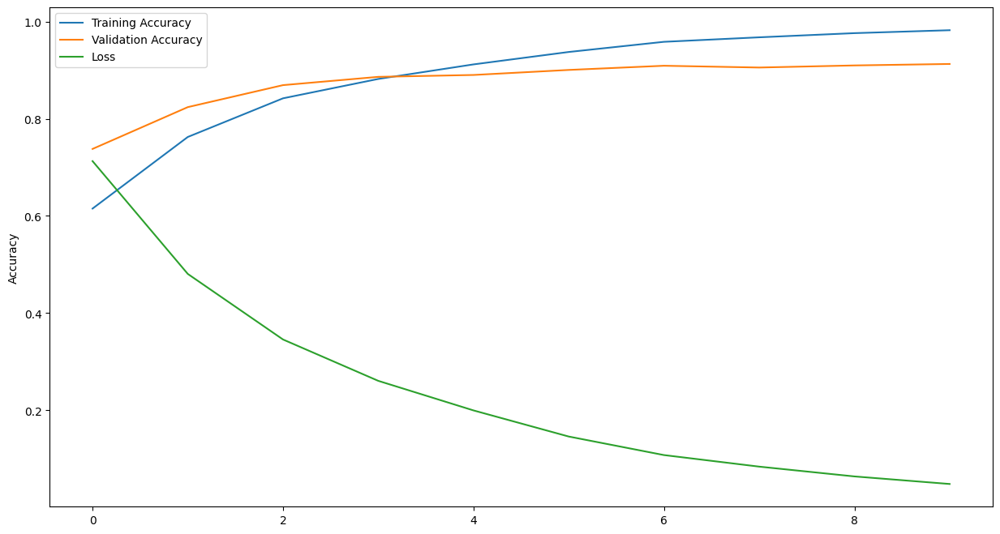

In [17]:
# Plot training and validation accuracy over epochs
plt.figure(figsize=(15, 8))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.plot(history.history['loss'], label='Loss')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [19]:
model.save("faces_pixel.h5")

In [3]:
model = tf.keras.models.load_model('faces_pixel.h5')

2024-04-12 14:35:16.411010: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-12 14:35:16.646196: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-12 14:35:16.646291: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-12 14:35:16.649101: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:2b:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-12 14:35:16.649181: I external/local_xla/xla/stream_executor

In [20]:
evaluation_result = model.evaluate(
    x=X_test,
    y=y_test
)

145/145 [==============================] - 1s 8ms/step - loss: 0.3304 - accuracy: 0.9127


145/145 [==============================] - 1s 6ms/step


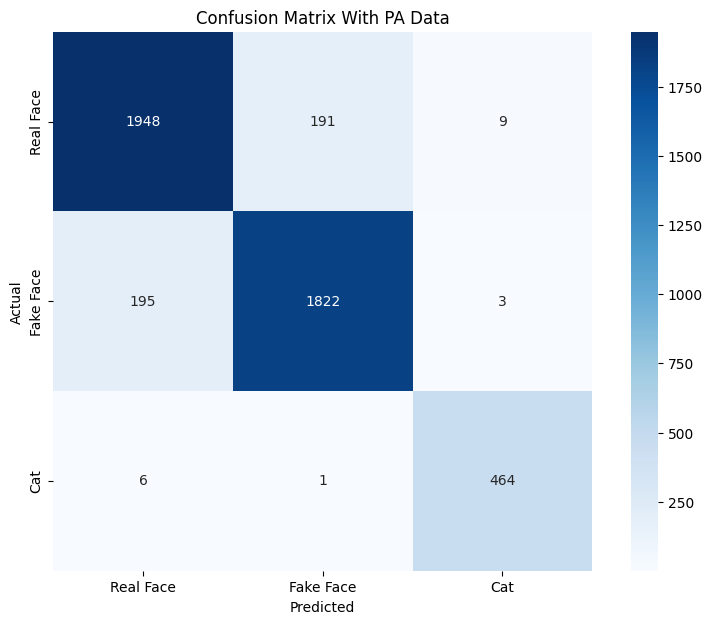

In [21]:
# Assuming model.predict outputs probabilities for each class
y_pred = model.predict(X_test)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix With PA Data')
plt.show()

In [22]:
# Pixel Attack imports
from art.attacks.evasion import PixelAttack
# Pixel Attack Classifier
classifier = TensorFlowV2Classifier(
    clip_values=(0, 1),
    model=model,
    nb_classes=3,
    input_shape=X_test[0].shape,
    loss_object=tf.keras.losses.CategoricalCrossentropy()
)

# Pixel attack attack declaration
p_attack = PixelAttack(classifier=classifier, th=10, max_iter=10, es=1,targeted=False, verbose=True)

In [23]:
# Generateing the adversarial examples
X_test_pixel = p_attack.generate(x=X_test,y=y_test)

Pixel threshold: 0it [00:00, ?it/s]

In [24]:
evaluation_result = model.evaluate(
    x=X_test_pixel,
    y=y_test
)

145/145 [==============================] - 1s 8ms/step - loss: 0.9728 - accuracy: 0.7349


145/145 [==============================] - 1s 6ms/step


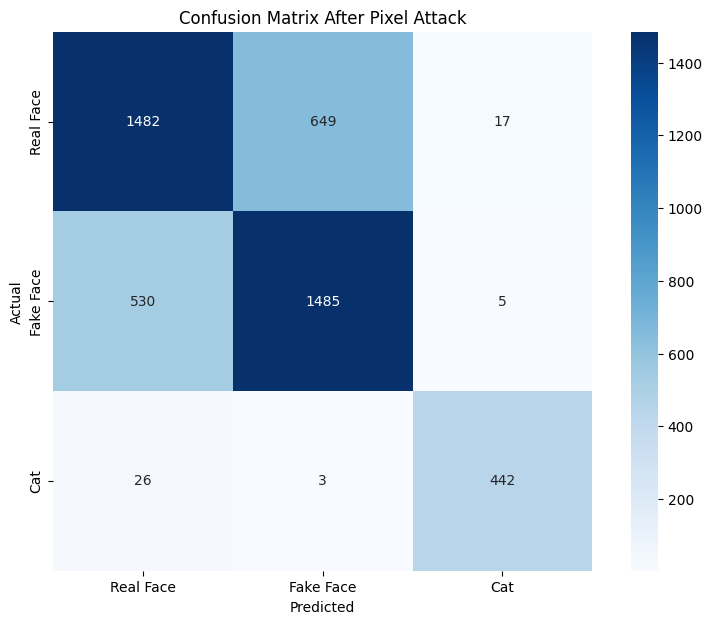

In [25]:
#Test my model on the adversarial examples
# Assuming model.predict outputs probabilities for each class
y_pred = model.predict(X_test_pixel)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix After Pixel Attack')
plt.show()

In [4]:
# Change the attack type to es=0
from art.attacks.evasion import PixelAttack
# Pixel Attack Classifier
classifier = TensorFlowV2Classifier(
    clip_values=(0, 1),
    model=model,
    nb_classes=3,
    input_shape=X_test[0].shape,
    loss_object=tf.keras.losses.CategoricalCrossentropy()
)

# Pixel attack attack declaration
p_attack = PixelAttack(classifier=classifier, th=10, max_iter=10, es=0,targeted=False, verbose=True)
# Generateing the adversarial examples
X_test_pixel = p_attack.generate(x=X_test,y=y_test)

Pixel threshold: 0it [00:00, ?it/s]

2024-04-12 14:35:20.347654: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2024-04-12 14:35:20.823419: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-12 14:35:21.676399: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


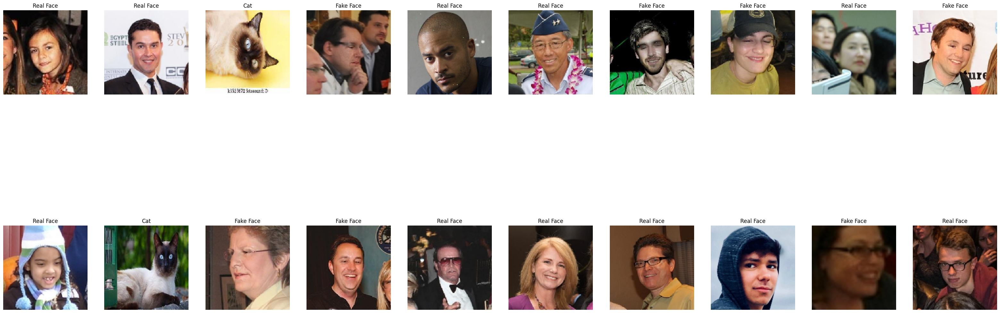

In [9]:
# Display the first 10 images:
plt.figure(figsize=(40, 16))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_test_pixel[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_test[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_test[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [6]:
evaluation_result = model.evaluate(
    x=X_test_pixel,
    y=y_test
)

145/145 [==============================] - 2s 7ms/step - loss: 0.3673 - accuracy: 0.8873


145/145 [==============================] - 1s 4ms/step


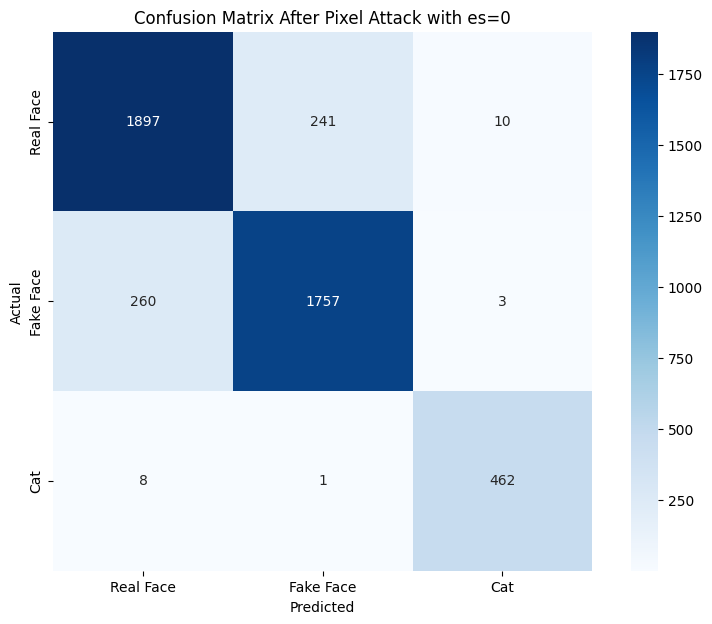

In [7]:
#Test my model on the adversarial examples
# Assuming model.predict outputs probabilities for each class
y_pred = model.predict(X_test_pixel)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix After Pixel Attack with es=0')
plt.show()

#### Training on GeoDA

In [27]:
def load_dataset(folder_paths, test_size=0.2, limiter=5000):
    X = []
    y = []
    # Update the dictionary to include the new category
    label_map = {'real': 0, 'fake': 1, 'cat': 2}
    
    for folder_path in folder_paths:
        # Determine the label from the folder name
        if 'real' in folder_path:
            label = label_map['real']
        elif 'fake' in folder_path:
            label = label_map['fake']
        elif 'cat' in folder_path:
            label = label_map['cat']
        else:
            continue  # Skip if the folder does not match any category

        files = os.listdir(folder_path)
        for filename in tqdm(files[:limiter], desc=f"Loading {folder_path}"):
            img = load_img(os.path.join(folder_path, filename), target_size=(150, 150))
            img_array = img_to_array(img)
            X.append(img_array)
            y.append(label)

    X = np.array(X)
    y = np.array(y)
    # Apply one-hot encoding to the labels
    y = to_categorical(y, num_classes=len(label_map))

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=42)
    return (X_train, y_train), (X_test, y_test)


# Paths to folders containing images:
folder_paths = [
    r"./face/real",
    r"./face/fake",
    r"./deep_fake_faces/Dataset/Train/real",
    r"./deep_fake_faces/Dataset/Train/fake",
    r"./cat",
    r"adversarial_examples_geo/real",
    r"adversarial_examples_geo/fake",
    r"adversarial_examples_geo/cat"
]

# Load dataset:
(X_train, y_train), (X_test, y_test) = load_dataset(folder_paths)
X_train = X_train / 255
X_test = X_test / 255

Loading adversarial_examples_geo/cat: 100%|██████████████████████████████████████████| 658/658 [00:04<00:00, 156.78it/s]


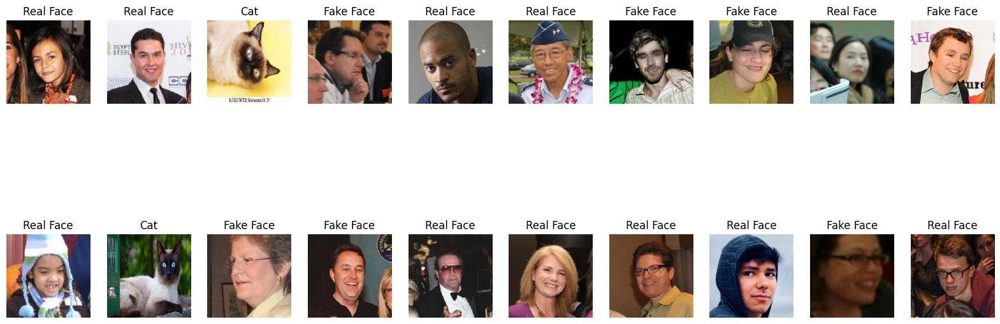

In [26]:
# Display the first 10 images:
plt.figure(figsize=(20, 8))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_test[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_test[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_test[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [28]:
def build_face_detector(input_shape=X_train[0].shape):
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
        layers.MaxPooling2D((2, 2), strides=(2, 2)),
        layers.Flatten(),
        layers.Dense(256, activation='relu'),
        layers.Dense(512, activation='relu'),
        layers.Dense(3, activation='softmax')  # Modified to output 2 units for one-hot encoding
    ])

    model.compile(optimizer='adam',
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])

    return model

model = build_face_detector()
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 150, 150, 32)      896       
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 75, 75, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_9 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_9 (MaxPoolin  (None, 37, 37, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_10 (Conv2D)          (None, 37, 37, 128)       73856     
                                                                 
 max_pooling2d_10 (MaxPooli  (None, 18, 18, 128)      

In [29]:
# Training the model with validation data:
history = model.fit(
    x=X_train,
    y=y_train,
    epochs=10,
    batch_size=32,
    validation_data=(X_test, y_test)
)

2024-04-11 23:08:19.185289: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 5009310000 exceeds 10% of free system memory.


Epoch 1/10
580/580 [==============================] - 11s 16ms/step - loss: 0.5716 - accuracy: 0.7101 - val_loss: 0.5174 - val_accuracy: 0.7577
Epoch 2/10
580/580 [==============================] - 7s 12ms/step - loss: 0.4061 - accuracy: 0.8024 - val_loss: 0.3757 - val_accuracy: 0.8155
Epoch 3/10
580/580 [==============================] - 7s 12ms/step - loss: 0.3234 - accuracy: 0.8475 - val_loss: 0.3416 - val_accuracy: 0.8416
Epoch 4/10
580/580 [==============================] - 7s 12ms/step - loss: 0.2565 - accuracy: 0.8831 - val_loss: 0.2570 - val_accuracy: 0.8888
Epoch 5/10
580/580 [==============================] - 7s 11ms/step - loss: 0.1968 - accuracy: 0.9121 - val_loss: 0.2465 - val_accuracy: 0.8905
Epoch 6/10
580/580 [==============================] - 7s 11ms/step - loss: 0.1526 - accuracy: 0.9341 - val_loss: 0.2430 - val_accuracy: 0.9028
Epoch 7/10
580/580 [==============================] - 7s 11ms/step - loss: 0.1186 - accuracy: 0.9505 - val_loss: 0.2597 - val_accuracy: 0.903

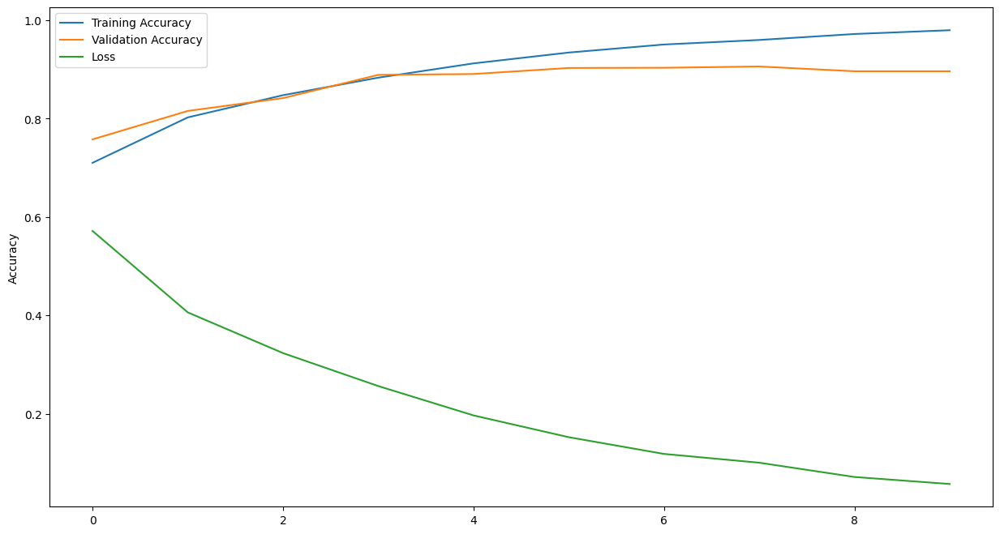

In [30]:
# Plot training and validation accuracy over epochs
plt.figure(figsize=(15, 8))
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.plot(history.history['loss'], label='Loss')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [31]:
model.save("faces_geo.h5")

In [32]:
evaluation_result = model.evaluate(
    x=X_test,
    y=y_test
)

145/145 [==============================] - 1s 8ms/step - loss: 0.3600 - accuracy: 0.8961


145/145 [==============================] - 1s 6ms/step


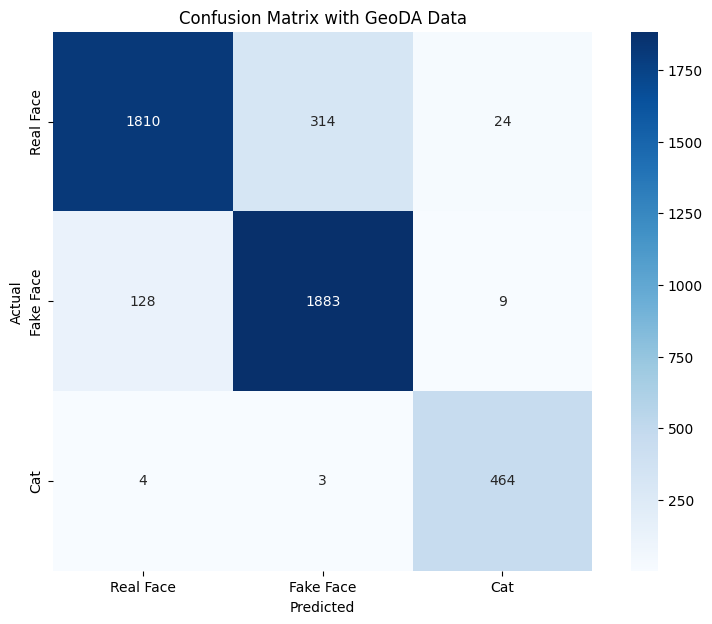

In [33]:
# Assuming model.predict outputs probabilities for each class
y_pred = model.predict(X_test)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix with GeoDA Data')
plt.show()

In [34]:
# Import the GeoDA attack
from art.attacks.evasion import GeoDA
# Create the classifier
g_classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=3,  # Adjust based on your model
    input_shape=X_test[0].shape,  # Adjust based on your model
    clip_values=(0, 1),
    loss_object=tf.keras.losses.CategoricalCrossentropy()
)
g_attack = GeoDA(
    estimator=g_classifier,
    batch_size=128,
    norm=2,
    sub_dim=10,
    max_iter=4000,  # Default value for a comprehensive test
    bin_search_tol=0.1,
    lambda_param=0.6,
    sigma=0.002,
    verbose=True
)

In [35]:
y_test_real_face = np.zeros((len(X_test), 3))  # Initialize with zeros for 3 classes
y_test_real_face[:, 0] = 1  # Set the first class (Real Face) to 1 for all instances


In [ ]:
# Generate the samples
X_test_geo = g_attack.generate(x=X_test, y=y_test_real_face)

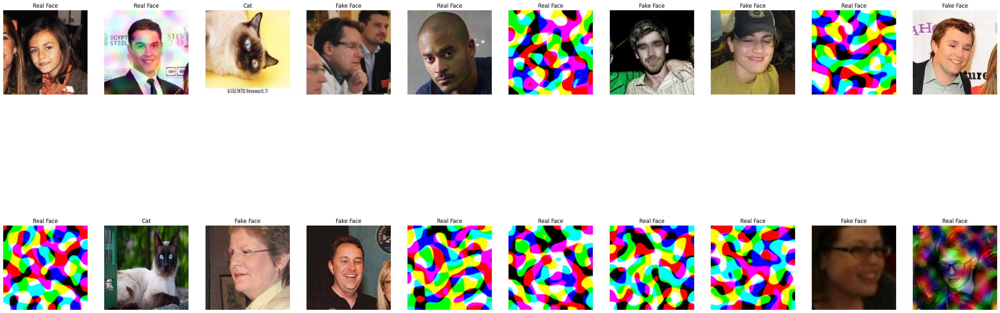

In [37]:
# Show some of the Adversarial Examples
plt.figure(figsize=(40, 16))
for i in range(20):
    plt.subplot(2, 10, i+1)
    plt.imshow(X_test_geo[i])  # Assuming X_test_pixel contains images in correct format
    # Determine label based on the one-hot encoded vector
    if np.argmax(y_test[i]) == 0:
        label = "Real Face"
    elif np.argmax(y_test[i]) == 1:
        label = "Fake Face"
    else:
        label = "Cat"
    plt.title(label)
    plt.axis('off')
plt.show()

In [38]:
evaluation_result = model.evaluate(
    x=X_test_geo,
    y=y_test
)

145/145 [==============================] - 1s 7ms/step - loss: 2.2283 - accuracy: 0.8888


145/145 [==============================] - 1s 5ms/step


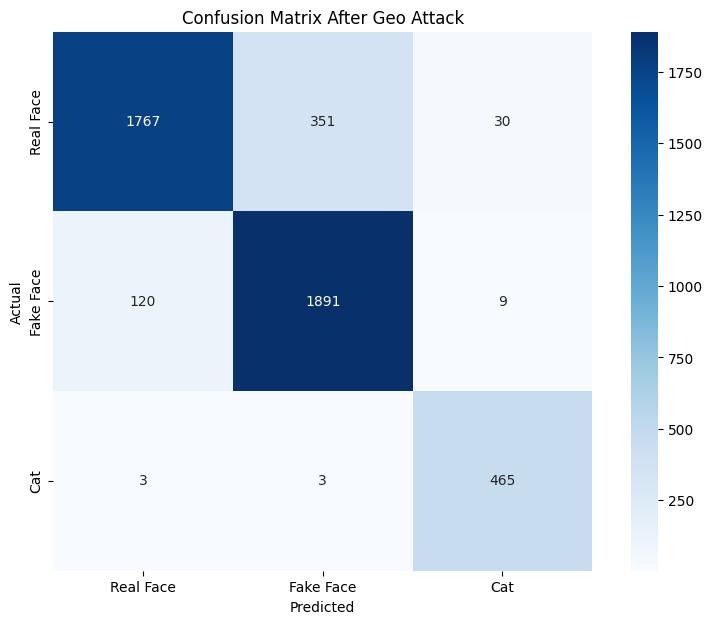

In [39]:
# Test it on my model
y_pred = model.predict(X_test_geo)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix After Geo Attack')
plt.show()

In [40]:
evaluation_result = model.evaluate(
    x=X_test_pixel,
    y=y_test
)

145/145 [==============================] - 1s 7ms/step - loss: 0.4362 - accuracy: 0.8726


145/145 [==============================] - 1s 7ms/step


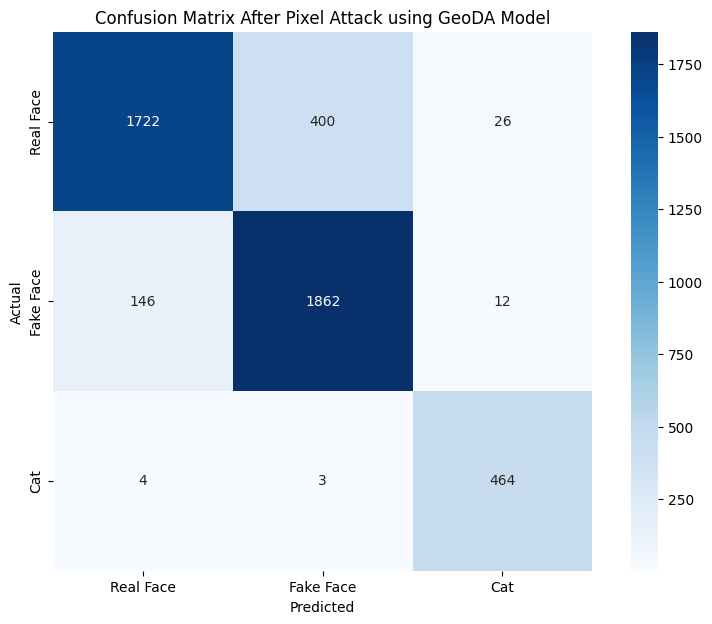

In [41]:
# Test it on my model
y_pred = model.predict(X_test_pixel)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix After Pixel Attack using GeoDA Model')
plt.show()

In [42]:
model = tf.keras.models.load_model('faces_pixel.h5')

In [43]:
evaluation_result = model.evaluate(
    x=X_test_geo,
    y=y_test
)

145/145 [==============================] - 2s 9ms/step - loss: 5.2595 - accuracy: 0.5477


145/145 [==============================] - 1s 7ms/step


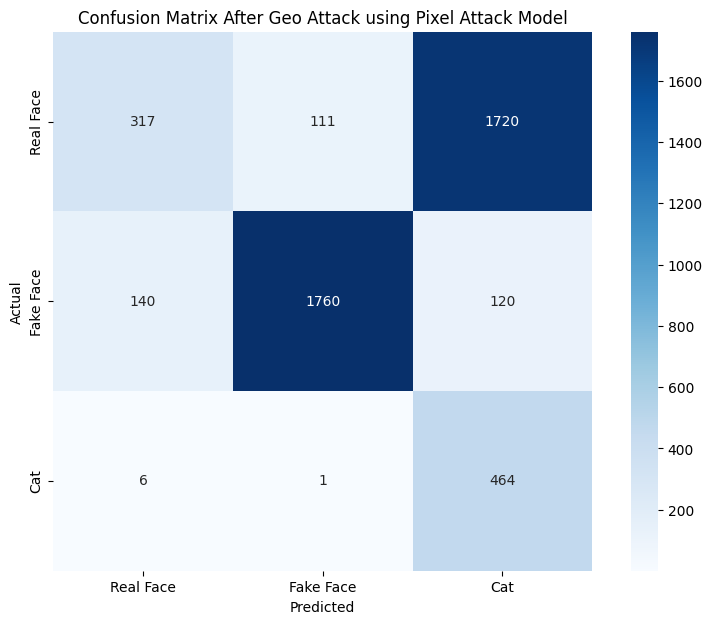

In [44]:
# Test it on my model
y_pred = model.predict(X_test_geo)

# Convert probabilities to class indices
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Update class labels to include "Cat" for "Gatto"
class_labels = ['Real Face', 'Fake Face', 'Cat']  # Updated labels to include "Cat" for "Gatto"

# Calculate confusion matrix
conf_matrix_b4_attacks = confusion_matrix(y_test_classes, y_pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix_b4_attacks, annot=True, fmt='d', cmap='Blues', square=True,
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix After Geo Attack using Pixel Attack Model')
plt.show()